# Structure

- Playback Kinetics three videos
- Call cluster and playback the 3 videos with clustered colors
- Call train and test with playback examples for both, metrics visualized as interactive graphs with tooltips?
    - show colorization results with original video side by side
- Include link to Tensorboard within project dir with port etc. instantiated from Jupyter. Can tensorboard show past runs?
- Show results of best models and Vondrick video playback + metrics in table

- Show results on all tasks in separate Jupyter notebooks
- For each task, include good and bad analysis
- Put everything in notebook in functions, try higher k and other such parameters for ablation studies in separate notebooks by import notebooks. **Show results in notebook, write helper functions in scripts**
- write video outputs and trained models to out dir
- clearly demarcate which model is Vondrick because you'll be using that on multiple tasks in **model** folder

# Video Colorization

In [1]:
import os, sys, argparse, logging
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import tensorflow as tf
import tensorpack.dataflow as df
from sklearn.cluster import KMeans

# path below only works on vision cluster for author
sys.path.append('/home/nfs/zpahuja2/tracking_from_colorization')

import colorizer as clr

cfg = clr.config.Config()

print("tensorflow version: {}".format(tf.VERSION)) # works with v1.10

tensorflow version: 1.10.0


### Exploring Kinetics dataset

Video understanding dataset from DeepMind collected by annotating YouTube videos for human activity recognition

---------
**TODO**

Playback 3 videos side by side

read from data dir, make gif in tmp dir and embed

(128, 128, 3) 2 0 240 320
(128, 128, 3) 2 1 240 320
(128, 128, 3) 2 0 720 1280
(128, 128, 3) 2 1 720 1280
(128, 128, 3) 2 0 360 640


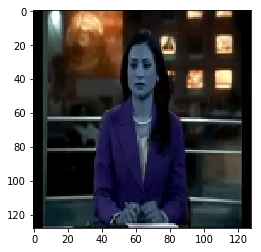

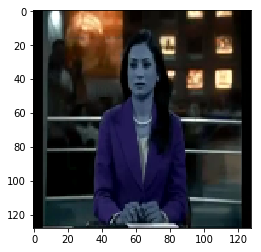

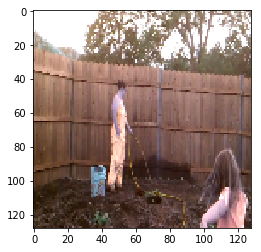

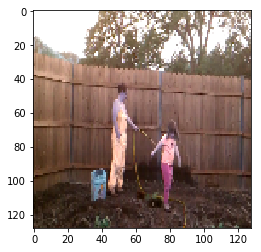

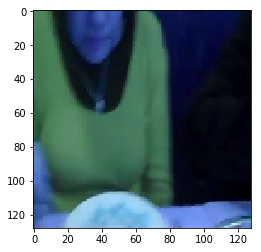

In [2]:
# get kinetics directory path from config.yaml
kinetics_dirpath = cfg['data_dir']['kinetics']

# get Kinetics video frames
ds = clr.dataset.Kinetics~~(kinetics_dirpath, num_frames=1, skips=[120], shuffle=False)
ds = df.MapData(ds, lambda dp: [dp[1][0], dp])
ds = df.MapDataComponent(ds, lambda image: cv2.resize(image, (128, 128)))

ds.reset_state()
generator = ds.get_data()

for _ in range(5):
    img, frame_index = next(generator)
    print(img.shape, len(frame_index), frame_index[0], len(frame_index[1][0]), len(frame_index[1][0][0]))
    plt.figure()
    plt.imshow(img, cmap='gray')

In [4]:
kinetics_dirpath = cfg['data_dir']['kinetics']

ds = clr.dataset.Kinetics(kinetics_dirpath, num_frames=1, skips=[120], shuffle=False)


In [6]:
generator = ds.get_data()

In [9]:
fname = ds.names[1]
exists, fp = ds.get_filename('003aVPFIf3k')
exists, fp

(True, '/data/zubin/videos/kinetics/processed/003aVPFIf3k.mp4')

In [24]:
from IPython.display import Video
Video("003aVPFIf3k.mp4", embed=True)

In [5]:
vid = clr.utils.io.VideoReader("003aVPFIf3k.mp4")

AttributeError: module 'colorizer.utils' has no attribute 'io'

In [14]:
!cp /data/zubin/videos/kinetics/processed/003aVPFIf3k.mp4 .

In [16]:
from IPython.display import HTML

In [18]:
%%HTML
<video width="320" height="240" controls>
  <source src="003aVPFIf3k.mp4" type="video/mp4">
</video>

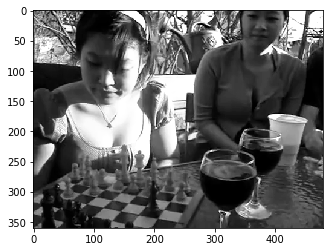

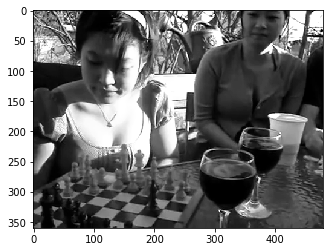

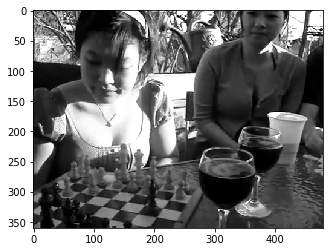

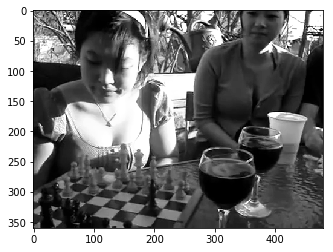

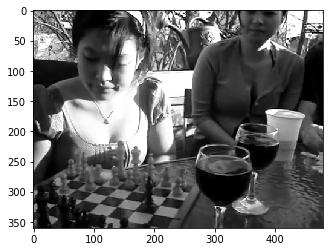

...

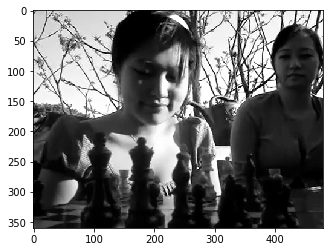

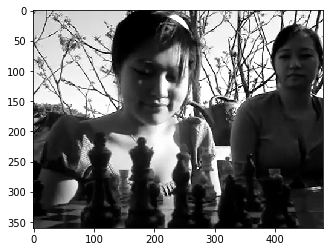

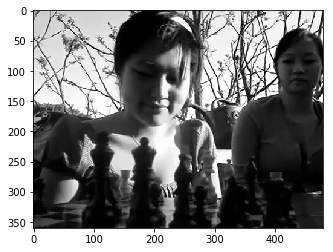

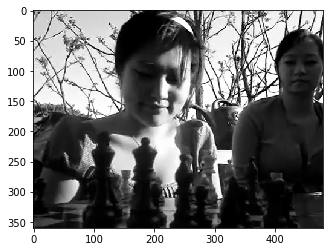

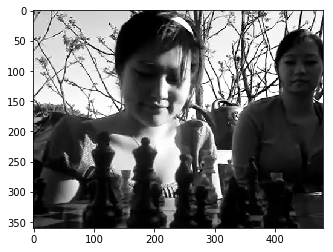

In [ ]:
import numpy as np
import cv2
%matplotlib inline
from matplotlib import pyplot as plt


cap = cv2.VideoCapture(fp)

while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()
    
    if not ret:
        continue

    # Our operations on the frame come here
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Display the resulting frame
#     cv2.imshow('frame',gray)
    plt.imshow(gray, cmap='gray')
    plt.show()
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# When everything done, release the capture
# cap.release()
# cv2.destroyAllWindows()

In [14]:
from bokeh.plotting import figure
from bokeh.io import output_notebook, show, push_notebook
import cv2
import time
output_notebook()

cap = cv2.VideoCapture(fp)
ret, frame = cap.read()
frame=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA) # because Bokeh expects a RGBA image
frame=cv2.flip(frame, -1) # because Bokeh flips vertically
width=frame.shape[1]
height=frame.shape[0]
p = figure(x_range=(0,width), y_range=(0,height), output_backend="webgl", width=width, height=height)
myImage = p.image_rgba(image=[frame], x=0, y=0, dw=width, dh=height)
show(p, notebook_handle=True)
while True:
    ret, frame = cap.read()
    if not ret:
        break
    frame=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA)
    frame=cv2.flip(frame, -1)
    myImage.data_source.data['image']=[frame]
    push_notebook()
    time.sleep(1/24.)

Loading BokehJS ...

In [ ]:
x = cv2.imread('dp.jpg')
# x = x[:,:,::-1]
cv2.imshow('image', x)

In [3]:
dir(clr)

['__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 'absolute_import',
 'config',
 'dataset']

In [4]:
from IPython import get_ipython;   
get_ipython().magic('reset -sf')

In [ ]:
ds = df.MapDataComponent(ds, lambda image: cv2.cvtColor(np.float32(image / 255.0), cv2.COLOR_RGB2Lab))
ds = df.MapDataComponent(ds, lambda image: image[:, :, 1:])
ds = df.MapDataComponent(ds, lambda image: image.reshape((-1, 2)))
ds = df.RepeatedData(ds, -1)
samples = []
for _ in range(args.num_samples):
    samples.append(next(generator)[0])

vectors = np.array(samples).reshape((-1, 2))
kmeans = KMeans(args.num_clusters).fit(vectors)
centroids = np.array(kmeans.cluster_centers_)

centroids = np.array(kmeans.cluster_centers_)

Play with Kinetics and DAVIS dataset frames and annotations